#### Import required packages  


# Hierarchical Clustering Code

This file contains code that was used to create hierarchical analysis section in 00_lab_3_Clustering file.

In [124]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
import warnings
warnings.simplefilter('ignore',DeprecationWarning)
import seaborn as sns
import time
import copy

from pylab import rcParams
#import hdbscan

from sklearn.model_selection import ShuffleSplit
from sklearn.preprocessing import StandardScaler

#from sklearn.datasets import make_blobs

from sklearn.ensemble import RandomForestClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_score

from sklearn import metrics
from sklearn import metrics as mt
from sklearn.metrics import log_loss
from sklearn.metrics import accuracy_score as acc
from sklearn.metrics import confusion_matrix as conf
from sklearn.metrics import f1_score, precision_score, recall_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support as score

from sklearn.cluster import KMeans

from tabulate import tabulate

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from __future__ import print_function

#### Read in cleaned  dataset from .csv file  

In [125]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... read in cleaned data set
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

data_dir = '../data/'
data_file = 'mashable_clean_dataset_for_lab_03.csv'

file_2_read = data_dir + data_file
df = pd.read_csv(file_2_read)

df_cluster = copy.deepcopy(df)

df_cluster.head()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... add 'popular' binary based 'shares' values
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

df_cluster['shares'] = np.exp(df_cluster['ln_shares'])
df_cluster['popular'] = np.where(df_cluster['shares'] > 1400, 1, 0)

df_cluster.head()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... read in t-SNE vectors
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

data_dir = '../data/'
data_file = 't_sne_mapping_perplex_0100.csv'

file_2_read = data_dir + data_file
df_tsne = pd.read_csv(file_2_read)

df_tsne.head()


,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,global_subjectivity,global_rate_positive_words,rate_positive_words,...,ln_self_reference_avg_sharess,ln_LDA_00,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares
0,0.757447,-1.164821,0,1,0,-0.112902,0,0.670593,0.346403,0.457827,...,-0.139965,1.320242,1.235123,-0.643623,-0.631127,-0.692339,-0.266190,0.100486,0.248162,-1.171081
1,-0.661657,-1.688626,0,0,0,-0.112902,0,-0.875228,0.201534,0.269096,...,-2.032745,2.255159,-0.413498,-0.597044,-0.592009,-0.647786,-0.080881,-0.937038,-0.740381,-0.976042
2,-0.661657,-0.641015,0,0,0,-0.112902,0,2.218418,0.989601,0.920026,...,0.047434,0.248240,-0.510740,-0.674579,-0.666507,1.573640,-0.660825,0.100486,-0.740381,-0.173712
3,-0.661657,-0.117210,0,1,0,-0.112902,0,-0.115874,0.103648,-0.081405,...,-2.032745,-0.619381,1.412882,1.105693,-0.686387,-0.744975,0.386392,0.640207,-0.740381,-0.413529
4,1.230482,-0.117210,0,0,0,-0.112902,0,0.601046,2.008329,0.936179,...,0.423196,-0.619083,-0.537434,-0.696925,-0.687885,2.111239,-0.412983,-0.937038,-0.005038,-1.343719


,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,global_subjectivity,global_rate_positive_words,rate_positive_words,...,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares,shares,popular
0,0.757447,-1.164821,0,1,0,-0.112902,0,0.670593,0.346403,0.457827,...,1.235123,-0.643623,-0.631127,-0.692339,-0.266190,0.100486,0.248162,-1.171081,0.310032,0
1,-0.661657,-1.688626,0,0,0,-0.112902,0,-0.875228,0.201534,0.269096,...,-0.413498,-0.597044,-0.592009,-0.647786,-0.080881,-0.937038,-0.740381,-0.976042,0.376799,0
2,-0.661657,-0.641015,0,0,0,-0.112902,0,2.218418,0.989601,0.920026,...,-0.510740,-0.674579,-0.666507,1.573640,-0.660825,0.100486,-0.740381,-0.173712,0.840539,0
3,-0.661657,-0.117210,0,1,0,-0.112902,0,-0.115874,0.103648,-0.081405,...,1.412882,1.105693,-0.686387,-0.744975,0.386392,0.640207,-0.740381,-0.413529,0.661312,0
4,1.230482,-0.117210,0,0,0,-0.112902,0,0.601046,2.008329,0.936179,...,-0.537434,-0.696925,-0.687885,2.111239,-0.412983,-0.937038,-0.005038,-1.343719,0.260874,0


,x-tsne,y-tsne,sample_index
0,13.380795,10.659998,6972
1,-9.200704,3.382056,11092
2,-29.567352,-1.899089,10229
3,-3.023949,21.598028,1319
4,-14.161682,-6.246559,29199


In [126]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... join t-sne vectors with base data, since we sampled to create
# ...     the t-sne mapping
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

df_join = df_tsne.join(df_cluster, on = 'sample_index')

df_join.head()

,x-tsne,y-tsne,sample_index,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,...,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares,shares,popular
0,13.380795,10.659998,6972,-0.661657,-1.688626,0,1,0,-0.348014,0,...,2.852511,-0.597480,-0.591652,-0.647785,0.099159,0.100486,1.591996,-0.507042,0.602275,0
1,-9.200704,3.382056,11092,-2.080761,-0.641015,0,0,0,0.972211,0,...,-0.510734,-0.674533,-0.666230,-0.723204,-0.348173,-0.937038,-0.740381,0.736897,2.089441,0
2,-29.567352,-1.899089,10229,-0.188622,-0.641015,0,0,0,0.402518,1,...,2.428048,-0.674663,0.109347,-0.723205,-1.553284,-1.481184,0.543219,-1.131931,0.322410,0
3,-3.023949,21.598028,1319,0.757447,-1.688626,0,0,1,-1.646262,0,...,-0.407681,-0.595744,-0.591331,-0.637070,1.941572,-0.937038,-0.551762,1.368603,3.929857,0
4,-14.161682,-6.246559,29199,0.757447,0.406595,0,0,0,-0.369743,0,...,-0.559803,1.972443,-0.703975,-0.276279,-0.104558,0.100486,-0.740381,-0.247860,0.780469,0


In [127]:
col_names = df_join.columns.values.tolist()
col_names
df_join.describe().T

['x-tsne',
 'y-tsne',
 'sample_index',
 'n_tokens_title',
 'num_keywords',
 'data_channel_is_lifestyle',
 'data_channel_is_entertainment',
 'data_channel_is_socmed',
 'kw_avg_max',
 'is_weekend',
 'global_subjectivity',
 'global_rate_positive_words',
 'rate_positive_words',
 'max_positive_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'ln_n_tokens_content',
 'ln_num_hrefs',
 'ln_num_imgs',
 'ln_num_videos',
 'ln_kw_min_min',
 'ln_kw_avg_min',
 'ln_kw_min_max',
 'ln_kw_avg_avg',
 'ln_self_reference_avg_sharess',
 'ln_LDA_00',
 'ln_LDA_01',
 'ln_LDA_02',
 'ln_LDA_03',
 'ln_LDA_04',
 'ln_global_rate_negative_words',
 'ln_min_positive_polarity',
 'ln_abs_title_sentiment_polarity',
 'ln_shares',
 'shares',
 'popular']

,count,mean,std,min,25%,50%,75%,max
x-tsne,13875.0,0.410117,14.157297,-32.599712,-10.773357,-0.665518,11.126032,32.072052
y-tsne,13875.0,0.040092,9.436279,-22.147314,-6.963444,-0.534287,6.482005,23.578930
sample_index,13875.0,20058.394739,11400.211047,0.000000,10224.000000,20189.000000,29834.500000,39642.000000
n_tokens_title,13875.0,-0.002783,0.997158,-3.972899,-0.661657,-0.188622,0.757447,4.068690
num_keywords,13875.0,-0.011052,0.997482,-3.260042,-0.641015,-0.117210,0.930401,1.454206
data_channel_is_lifestyle,13875.0,0.050739,0.219472,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_entertainment,13875.0,0.178739,0.383147,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_socmed,13875.0,0.057658,0.233103,0.000000,0.000000,0.000000,0.000000,1.000000
kw_avg_max,13875.0,0.021806,0.998054,-1.911764,-0.621457,-0.091469,0.551779,4.335148
is_weekend,13875.0,0.130450,0.336810,0.000000,0.000000,0.000000,0.000000,1.000000


#### Create table for comparison of models

In [128]:
# set required variables for model comparison

comparison_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

### t-SNE  

create t-SNE vectors to use for building models.

C:\Users\Preeti\Anaconda3\lib\site-packages\matplotlib\cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


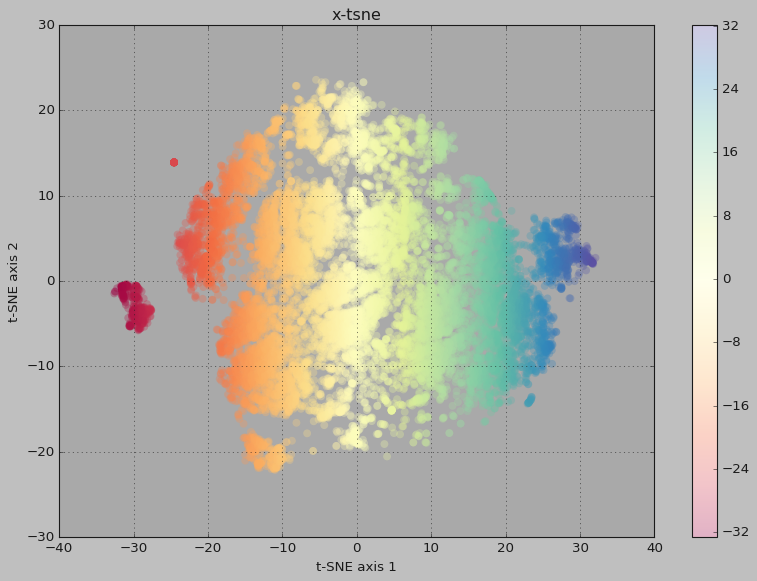

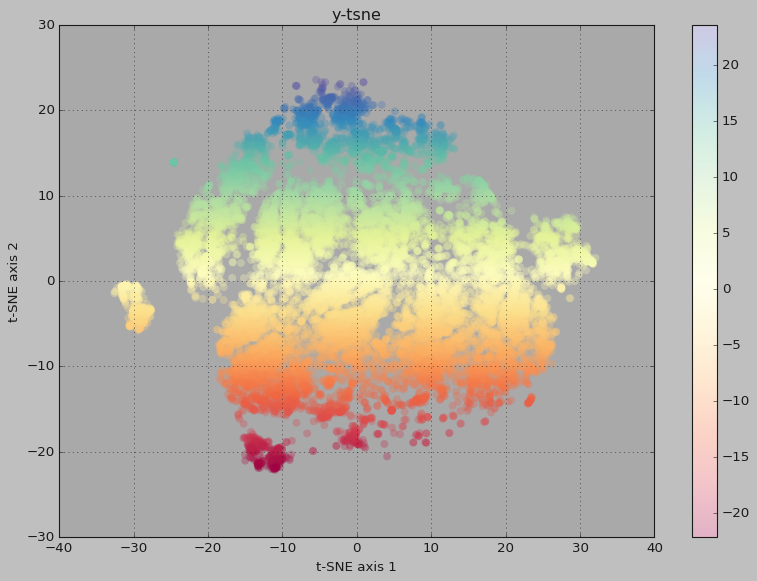

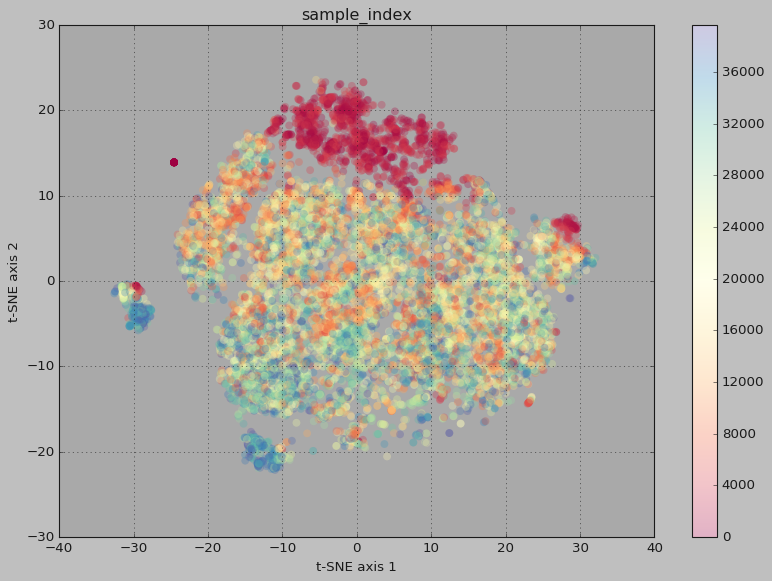

In [129]:
from ggplot import *
from ggplot import scale_fill_brewer
from matplotlib import cm

X_tsne = pd.DataFrame(columns=['t1', 't2'])
X_tsne['t1'] = df_join['x-tsne']
X_tsne['t2'] = df_join['y-tsne']

col_names = df_tsne.columns.values.tolist()

for col in col_names :
    _= plt.figure(figsize=(12, 8));
    _= plt.subplot(111, axisbg='darkgrey');
    _= plt.scatter(df_tsne['x-tsne'], df_tsne['y-tsne'],
                 c = df_tsne[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _= plt.colorbar()
    _= plt.xlabel('t-SNE axis 1')
    _= plt.ylabel('t-SNE axis 2')
    _= plt.title(col)
    _= plt.grid(True)
    _= plt.show();


In [130]:
X_tsne
print("Number of records in t-sne: ",len(X_tsne))
print("Number of records in X1: ",len(X1))

,t1,t2
0,13.380795,10.659998
1,-9.200704,3.382056
2,-29.567352,-1.899089
3,-3.023949,21.598028
4,-14.161682,-6.246559
5,-10.652346,18.585279
6,5.650054,5.369233
7,11.489187,15.465608
8,-29.778311,-3.711626
9,-31.479572,-0.698514


Number of records in t-sne:  13875


NameError: name 'X1' is not defined

We can see that t-SNE created two components (2 columns) for each of the records. An entire row has been reduced to a 2 feature values.

In [ ]:
# set required variables for model comparison

tsne_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

### Modeling Evaluation 1: Train and Adjust paraments

Under this section we will build 3 hierarchical models based on the methods (Ward, Complete, Average). We will compare the 3 models behaviour, identify any patters within.

To identify number of clusters needed we will be using dendrogram. 

Once the models are run, we will look into summary table for silhoutte value and processing time. 


In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering

# Using the dendrogram to find the optimal number of clusters
dendrogram = sch.dendrogram(sch.linkage(X_tsne, method = 'complete'))
_ = plt.title('Dendrogram, type=complete')
_ = plt.xlabel('X_tsne')
_ = plt.ylabel('Euclidean distances')
plt.savefig("../plots/hierarchical/dendrogram_complete.png")
_ = plt.show()


# Using the dendrogram to find the optimal number of clusters
dendrogram = sch.dendrogram(sch.linkage(X_tsne, method = 'average'))
_ = plt.title('Dendrogram, type=average')
_ = plt.xlabel('X_tsne')
_ = plt.ylabel('Euclidean distances')
plt.savefig("../plots/hierarchical/dendrogram_average.png")
_ = plt.show()


# Using the dendrogram to find the optimal number of clusters
dendrogram = sch.dendrogram(sch.linkage(X_tsne, method = 'ward'))
_ = plt.title('Dendrogram, type=ward')
_ = plt.xlabel('X_tsne')
_ = plt.ylabel('Euclidean distances')
plt.savefig("../plots/hierarchical/dendrogram_ward.png")
_ = plt.show()

In [ ]:
n_optimal_cluster_ward = 2
n_optimal_cluster_average = 4
n_optimal_cluster_complete = 3

In [ ]:

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... optimal models for linkage = ward
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

tic = time.clock()
hc_ward = AgglomerativeClustering(n_clusters = n_optimal_cluster_ward, affinity = 'euclidean', linkage = 'ward')
hc_ward.fit(X_tsne)

hc_labels_ward = hc_ward.labels_ # the labels from hierarchical clustering
#hc_centers = hc_lda.cluster_centers_

# hc_inertia = hc_lda.inertia_
#print ("inertia = ", hc_inertia)

hc_silhouette = metrics.silhouette_score(X_tsne,
                                             hc_labels_ward,
                                             metric = 'euclidean',
                                             sample_size = 10000)
print ("silhouette = ", hc_silhouette)

toc =  time.clock()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

exe_time = '{0:.4f}'.format(toc-tic)

raw_data = {
'model_name' : 'hierarchical - ward',
'n_clusters' : n_optimal_cluster_ward,
'inertia': 'NA',
'silhouette': hc_silhouette, 
'process_time' : exe_time
}

df_tbl = pd.DataFrame(raw_data,
columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
index = [i_index + 1])

tsne_tbl = tsne_tbl.append(df_tbl)
    

In [ ]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... optimal models for linkage = complete, #of clusters = 3
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

tic = time.clock()
hc_complete = AgglomerativeClustering(n_clusters = n_optimal_cluster_complete, affinity = 'euclidean', linkage = 'complete')
hc_complete.fit(X_tsne)

hc_labels_complete = hc_complete.labels_ # the labels from hierarchical clustering
#hc_centers = hc_lda.cluster_centers_

# hc_inertia = hc_lda.inertia_
#print ("inertia = ", hc_inertia)

hc_silhouette = metrics.silhouette_score(X_tsne,
                                             hc_labels_complete,
                                             metric = 'euclidean',
                                             sample_size = 10000)
print ("silhouette = ", hc_silhouette)

toc =  time.clock()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

exe_time = '{0:.4f}'.format(toc-tic)

raw_data = {
'model_name' : 'hierarchical - complete',
'n_clusters' : n_optimal_cluster_complete,
'inertia': 'NA',
'silhouette': hc_silhouette, 
'process_time' : exe_time
}

df_tbl = pd.DataFrame(raw_data,
columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
index = [i_index + 1])

tsne_tbl = tsne_tbl.append(df_tbl)

In [ ]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... optimal models for linkage = average #of clusters = 4
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

tic = time.clock()
hc_average = AgglomerativeClustering(n_clusters = n_optimal_cluster_average, affinity = 'euclidean', linkage = 'average')
hc_average.fit(X_tsne)

hc_labels_average = hc_average.labels_ # the labels from hierarchical clustering
#hc_centers = hc_lda.cluster_centers_

# hc_inertia = hc_lda.inertia_
#print ("inertia = ", hc_inertia)

hc_silhouette = metrics.silhouette_score(X_tsne,
                                             hc_labels_average,
                                             metric = 'euclidean',
                                             sample_size = 10000)
print ("silhouette = ", hc_silhouette)

toc =  time.clock()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

exe_time = '{0:.4f}'.format(toc-tic)

raw_data = {
'model_name' : 'hierarchical - average',
'n_clusters' : n_optimal_cluster_average,
'inertia': 'NA',
'silhouette': hc_silhouette, 
'process_time' : exe_time
}

df_tbl = pd.DataFrame(raw_data,
columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
index = [i_index + 1])

tsne_tbl = tsne_tbl.append(df_tbl)

# Modeling and Evaluation 2: Evaluate and compare
### Hierarchical model summary:

In [ ]:
tsne_tbl = tsne_tbl.reset_index(drop=True)
tsne_tbl['process_time'] = pd.to_numeric(tsne_tbl['process_time'])
tsne_tbl

Looking at the table above we can see 'Ward' gives best score of the three models. But, a score of .40 is not a good model. 

In [ ]:
sns.set_context('poster')
sns.set_color_codes()
plot_kwds = {'alpha' : 0.25, 's' : 80, 'linewidths':0}


palette = sns.color_palette('deep', np.unique(hc_labels_ward).max() + 1)
colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in hc_labels_ward]
X_tsne_values = X_tsne.values;
_= plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1], c=colors, **plot_kwds)
frame = plt.gca()
frame.axes.get_xaxis().set_visible(False)
frame.axes.get_yaxis().set_visible(False)
_= plt.title('Hierarchical Clusters, type = ward ' , fontsize=16)
_ = plt.xlabel("X_tsne");
_ = plt.ylabel("y_tsne");
plt.savefig("../plots/hierarchical/hc_ward_eval.png")
_=plt.show()

palette = sns.color_palette('deep', np.unique(hc_labels_average).max() + 1)
colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in hc_labels_average]
X_tsne_values = X_tsne.values;
_= plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1], c=colors, **plot_kwds)
frame = plt.gca()
frame.axes.get_xaxis().set_visible(False)
frame.axes.get_yaxis().set_visible(False)
_= plt.title('Hierarchical Clusters, type = average' , fontsize=16)
plt.savefig("../plots/hierarchical/hc_average_eval.png")
_=plt.show()

palette = sns.color_palette('deep', np.unique(hc_labels_complete).max() + 1)
colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in hc_labels_complete]
X_tsne_values = X_tsne.values;
_= plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1], c=colors, **plot_kwds)
frame = plt.gca()
frame.axes.get_xaxis().set_visible(False)
frame.axes.get_yaxis().set_visible(False)
_= plt.title('Hierarchical Clusters, type = complete' , fontsize=16)
plt.savefig("../plots/hierarchical/hc_complete_eval.png")
_=plt.show()



# Modeling and Evaluation 3: Visualize results

In [ ]:
X_all_together = copy.deepcopy(df_join)

len(X_all_together)

X_all_together['kmeans_labels'] = hc_labels_complete

#X_all_together.describe().T

In [ ]:
X_all_together['kmeans_labels'] = hc_labels_complete
hc_complete_centers_x = X_all_together.groupby(['kmeans_labels'])['x-tsne'].mean()
hc_complete_centers_y= X_all_together.groupby(['kmeans_labels'])['y-tsne'].mean()
hc_complete_centers_x
hc_complete_centers_y
n_lda = np.unique(hc_labels_complete).max() +1
n_lda

#### feature importance for complete method

X_HC_complete_analysis = copy.deepcopy(X_all_together)
del X_HC_complete_analysis['x-tsne']
del X_HC_complete_analysis['y-tsne']
del X_HC_complete_analysis['sample_index']

grouped = X_HC_complete_analysis.groupby(['kmeans_labels'])

HC_Complete_analysis_tbl = (grouped.mean() - X_HC_complete_analysis.mean()) / X_HC_complete_analysis.std()

#HC_Complete_analysis_tbl

##### Plot sprectrum, box-whiskers, cluster plots for all features in t-SNE dimension

We will plot for all features for each linkage type

#### a. Complete

In [ ]:
# boxplot across clusters for each feature ...
import seaborn as sns
sns.set_palette("husl")
plt.style.use('classic')

col_names = X_all_together.columns.values.tolist()

for col in col_names :
    
    _ = plt.figure(figsize=(24, 8));
    
# ... feature distribution color map 

    _ = plt.subplot(131, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)
    
# ... feature boxplots

    _ = plt.subplot(132, facecolor = 'darkgrey');
    ax = sns.boxplot(x = "kmeans_labels", y = col, data = X_all_together);
    #sns.axlabel(xlabel="hc_labels_complete");
    _ = plt.xlabel("hc_labels_complete");
    _ = plt.title(col)
    
    average_values = X_all_together.groupby(['kmeans_labels'])[col].mean().values
    average_labels = [str(np.round(s, 2)) for s in average_values]

    pos = range(len(average_values))
    for tick, label in zip(pos, ax.get_xticklabels()):
        
        _ = ax.text(pos[tick], average_values[tick], average_labels[tick], 
                horizontalalignment = 'center', size = 'small', color = 'w', weight = 'semibold')

# ... cluster color map
    
    _ = plt.subplot(133, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = hc_labels_complete,
                 cmap = plt.cm.tab20,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    for ii in range(n_lda) :                                       
           _ = plt.text(hc_complete_centers_x[ii], hc_complete_centers_y[ii], ii, fontsize = 20)
        
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    _ = plt.title('t-SNE 2-D mapping')
    _ = plt.title(col)
    plt.savefig("../plots/hierarchical/cluster_HC_complete_3way_preplx_100__4clstrs%s.png" %col)
    _ = plt.show();

#### b. Ward

In [120]:
X_all_together['kmeans_labels'] = hc_labels_ward
hc_centers_x = X_all_together.groupby(['kmeans_labels'])['x-tsne'].mean()
hc_centers_y= X_all_together.groupby(['kmeans_labels'])['y-tsne'].mean()
hc_centers_x
hc_centers_y
n_lda = np.unique(hc_labels_ward).max() +1
n_lda

#### feature importance for ward method

X_HC_ward_analysis = copy.deepcopy(X_all_together)
del X_HC_ward_analysis['x-tsne']
del X_HC_ward_analysis['y-tsne']
del X_HC_ward_analysis['sample_index']

grouped = X_HC_ward_analysis.groupby(['kmeans_labels'])

HC_ward_analysis_tbl = (grouped.mean() - X_HC_ward_analysis.mean()) / X_HC_ward_analysis.std()

kmeans_labels
0    -7.105234
1    17.430177
Name: x-tsne, dtype: float64

kmeans_labels
0    1.200402
1   -2.587669
Name: y-tsne, dtype: float64

2

kmeans_labels,0,1
abs_title_subjectivity,0.036268,-0.082137
data_channel_is_entertainment,-0.347189,0.786281
data_channel_is_lifestyle,0.058530,-0.132553
data_channel_is_socmed,0.057516,-0.130258
global_rate_positive_words,-0.059829,0.135494
global_subjectivity,-0.183434,0.415425
is_weekend,-0.014370,0.032544
kmeans_labels,NaN,NaN
kw_avg_max,-0.146057,0.330775
ln_LDA_00,0.195519,-0.442792


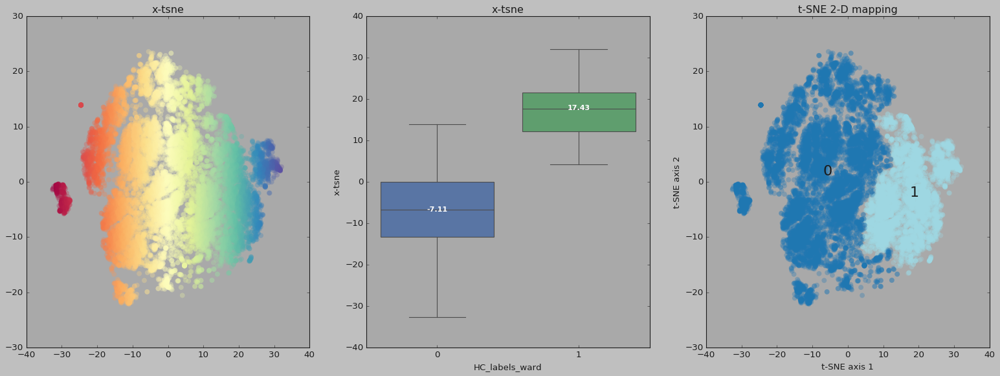

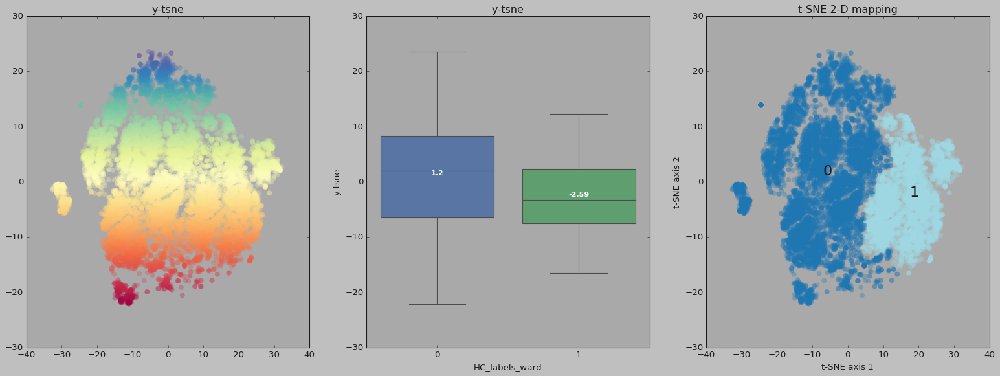

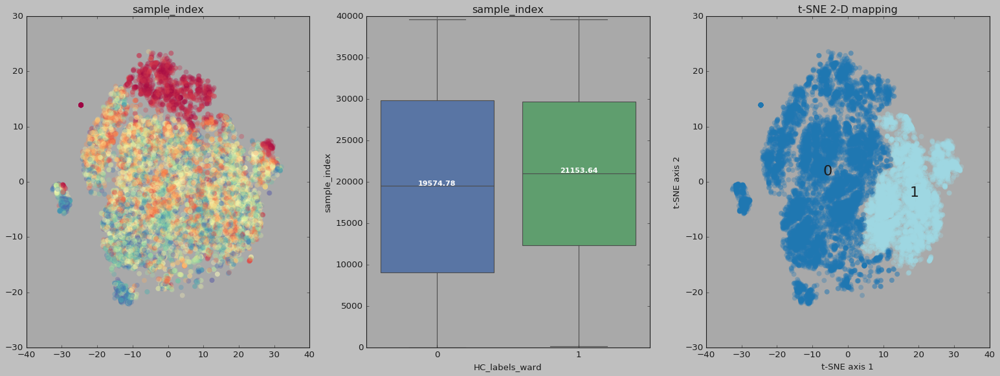

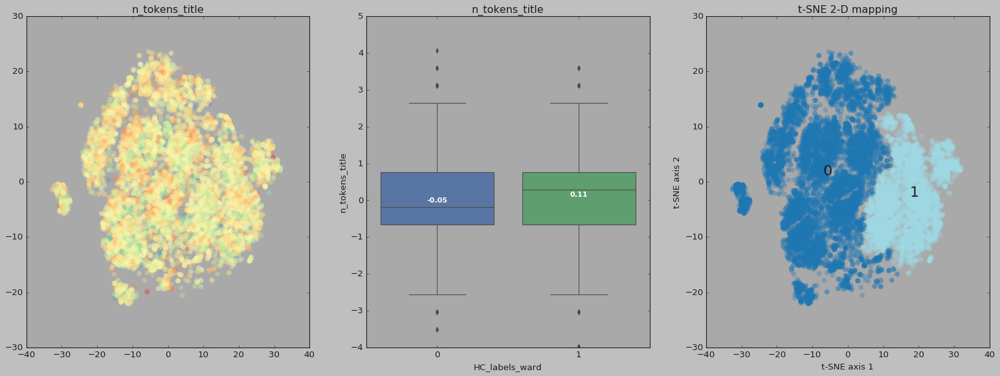

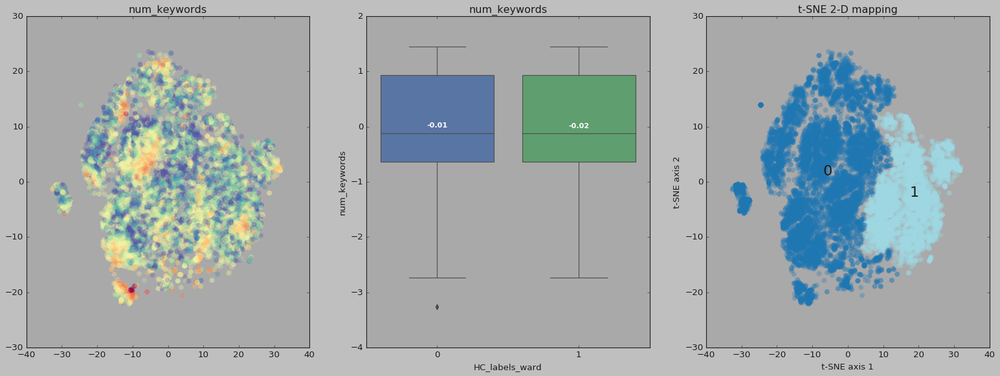

...

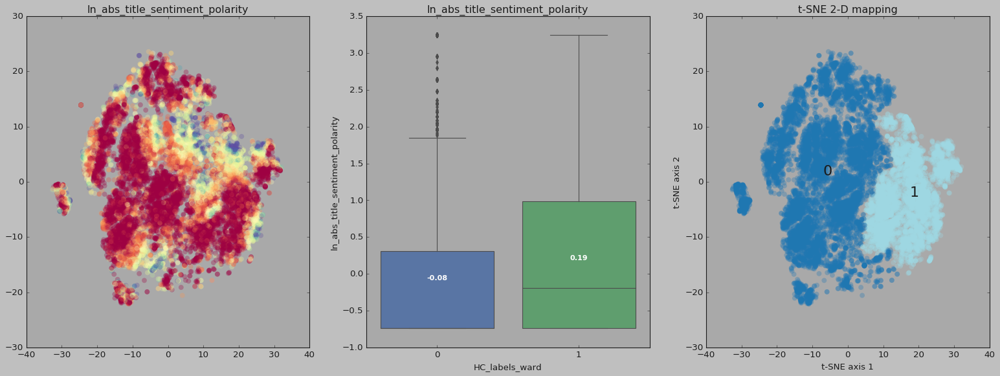

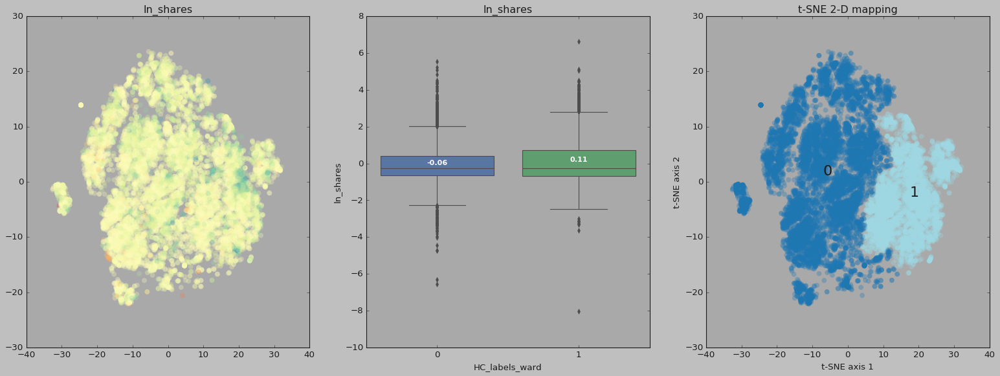

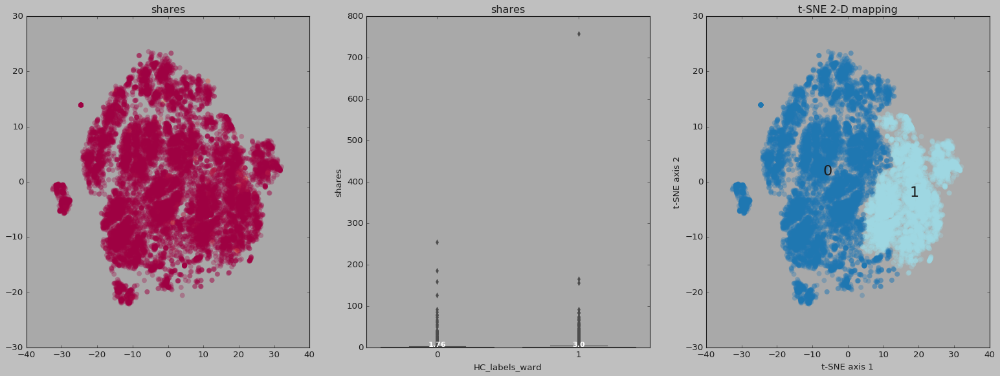

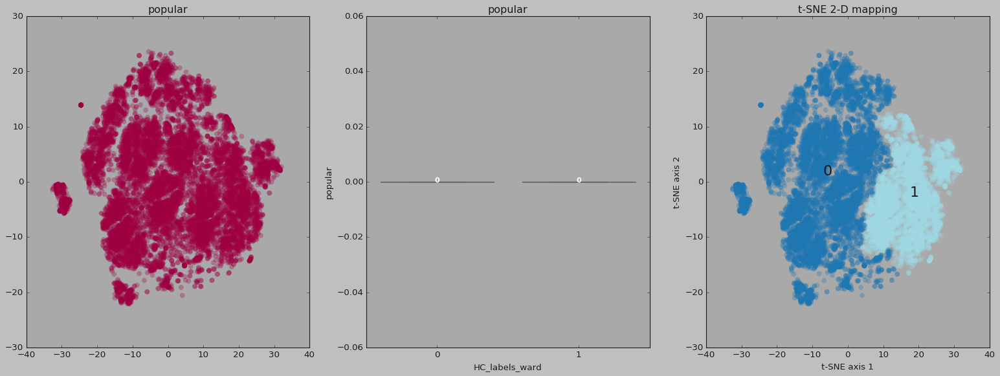

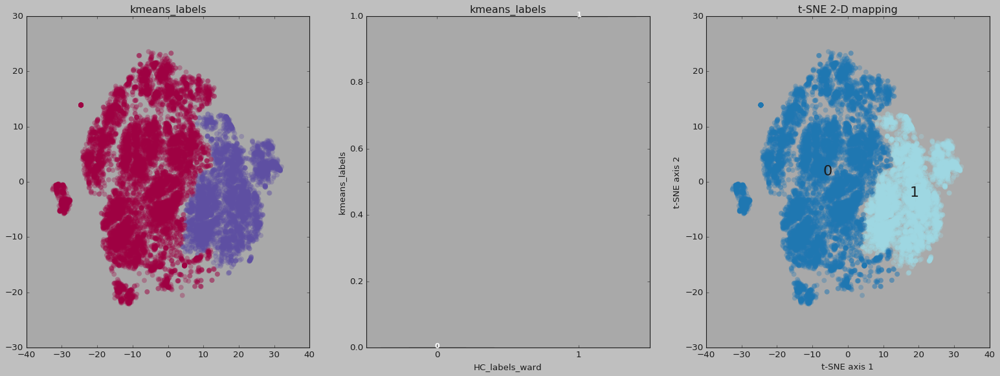

In [122]:
# boxplot across clusters for each feature ...
import seaborn as sns
sns.set_palette("husl")
plt.style.use('classic')


col_names = X_all_together.columns.values.tolist()

for col in col_names :
    
    _ = plt.figure(figsize=(24, 8));
    
# ... feature distribution color map 

    _ = plt.subplot(131, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)
    
# ... feature boxplots

    _ = plt.subplot(132, facecolor = 'darkgrey');
    ax = sns.boxplot(x = "kmeans_labels", y = col, data = X_all_together);
    _ = plt.xlabel("HC_labels_ward");
    _ = plt.title(col)
    average_values = X_all_together.groupby(['kmeans_labels'])[col].mean().values
    average_labels = [str(np.round(s, 2)) for s in average_values]

    pos = range(len(average_values))
    for tick, label in zip(pos, ax.get_xticklabels()):
        
        _ = ax.text(pos[tick], average_values[tick], average_labels[tick], 
                horizontalalignment = 'center', size = 'small', color = 'w', weight = 'semibold')

# ... cluster color map
    
    _ = plt.subplot(133, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = hc_labels_ward,
                 cmap = plt.cm.tab20,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    for ii in range(n_lda) :                                       
          _ = plt.text(hc_centers_x[ii], hc_centers_y[ii], ii, fontsize = 20)

    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    _ = plt.title('t-SNE 2-D mapping')
    #plt.savefig("../plots/hierarchical/cluster_HC_ward_3way_preplx_100__4clstrs%s.png" %col)

    _ = plt.show();

In [123]:
X_all_together['kmeans_labels'] = hc_labels_average
hc_centers_x = X_all_together.groupby(['kmeans_labels'])['x-tsne'].mean()
hc_centers_y= X_all_together.groupby(['kmeans_labels'])['y-tsne'].mean()
hc_centers_x
hc_centers_y
n_lda = np.unique(hc_labels_average).max() +1
n_lda

#### feature importance for ward method

X_HC_average_analysis = copy.deepcopy(X_all_together)
del X_HC_average_analysis['x-tsne']
del X_HC_average_analysis['y-tsne']
del X_HC_average_analysis['sample_index']

grouped = X_HC_average_analysis.groupby(['kmeans_labels'])

HC_average_analysis_tbl = (grouped.mean() - X_HC_average_analysis.mean()) / X_HC_average_analysis.std()

HC_average_analysis_tbl.T

kmeans_labels
0    -5.903750
1    -6.393442
2   -29.875178
3    17.554966
Name: x-tsne, dtype: float64

kmeans_labels
0    9.049248
1   -8.671239
2   -2.926156
3   -2.559425
Name: y-tsne, dtype: float64

4

kmeans_labels,0,1,2,3
abs_title_subjectivity,-0.156198,0.298019,-0.028053,-0.087397
data_channel_is_entertainment,-0.355842,-0.352884,-0.018326,0.778840
data_channel_is_lifestyle,0.129950,-0.013567,-0.162150,-0.133002
data_channel_is_socmed,0.175419,-0.083007,-0.160683,-0.123414
global_rate_positive_words,0.311925,-0.331684,-2.286608,0.143412
global_subjectivity,0.055227,-0.131420,-3.845701,0.417248
is_weekend,-0.026106,-0.003258,-0.012434,0.036635
kmeans_labels,NaN,NaN,NaN,NaN
kw_avg_max,-0.350203,0.016460,0.909943,0.333213
ln_LDA_00,0.638656,-0.328086,-0.393350,-0.442654


#### c. Average

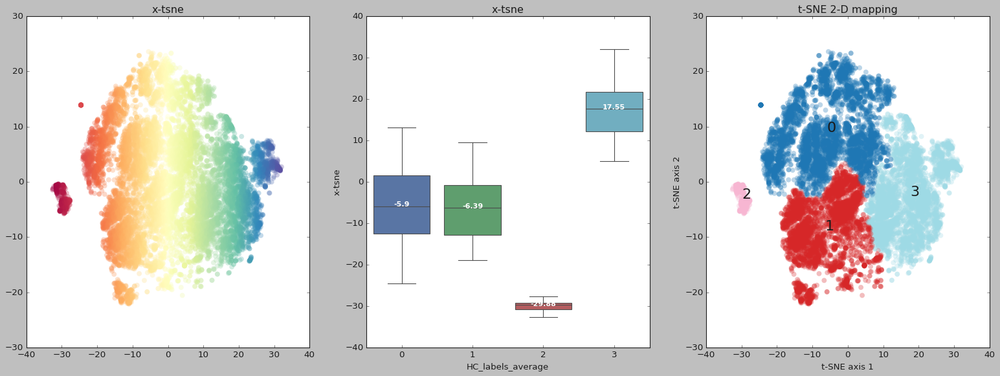

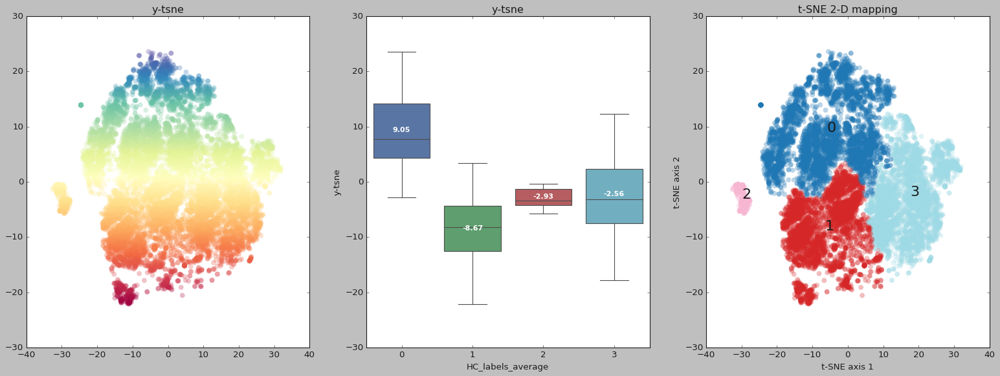

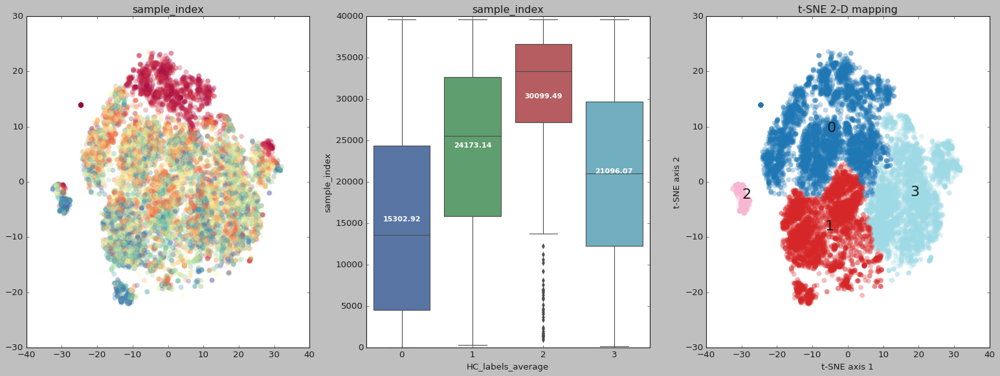

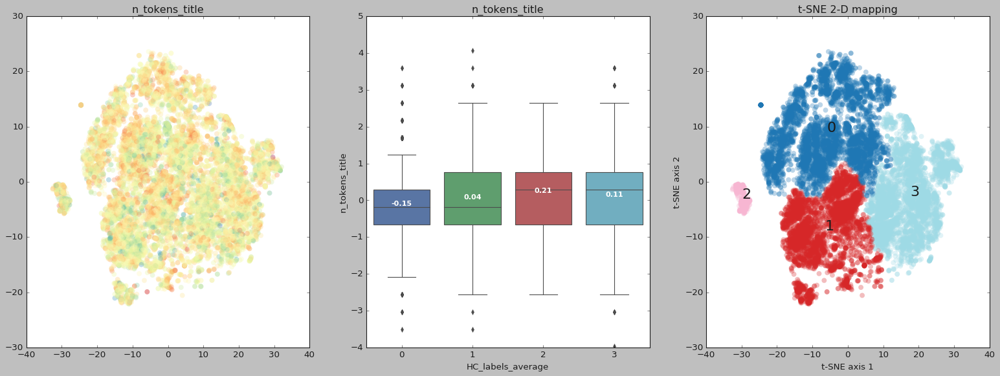

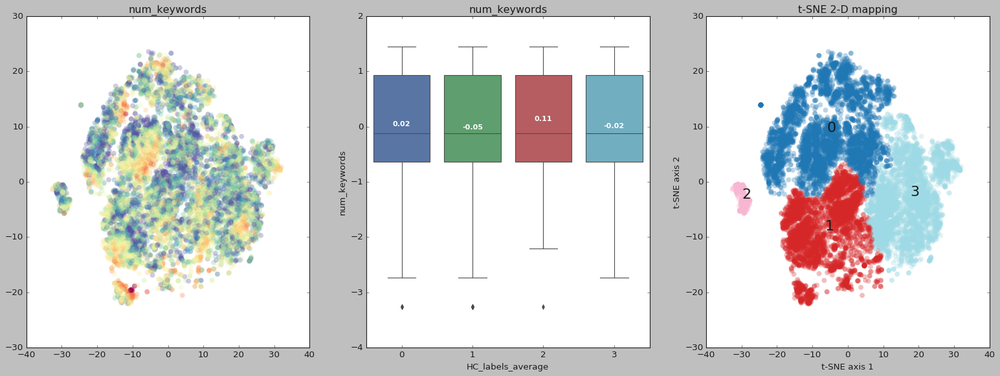

...

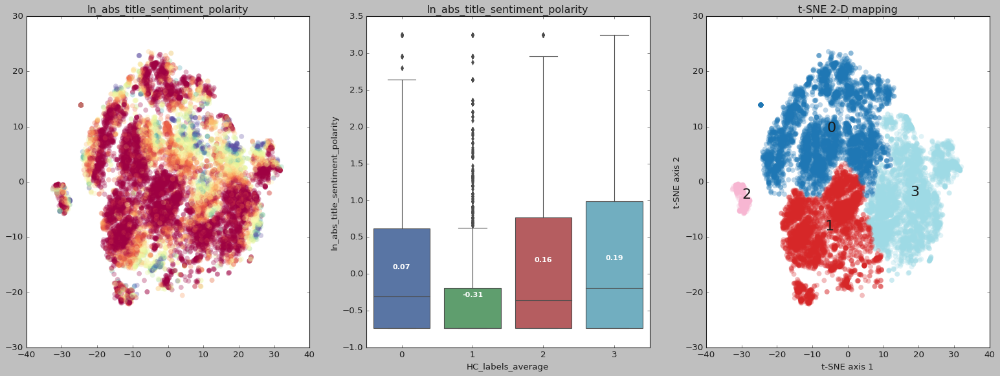

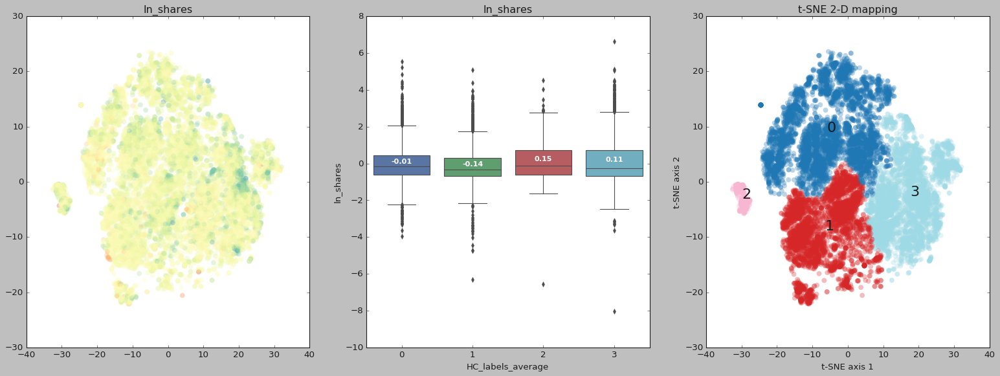

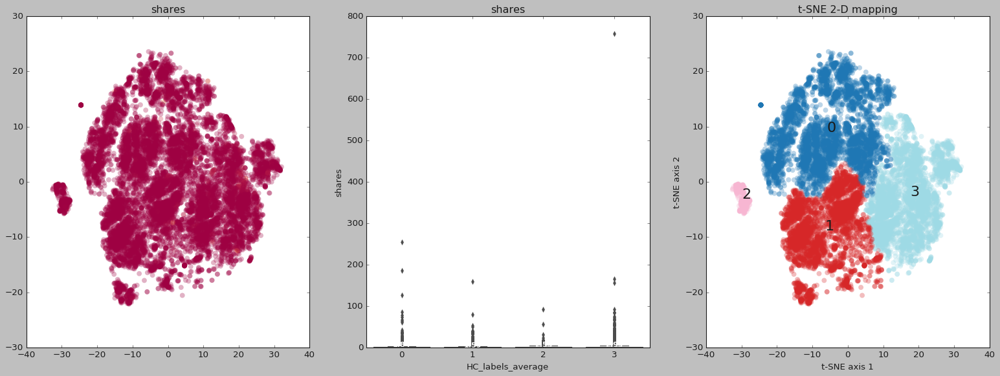

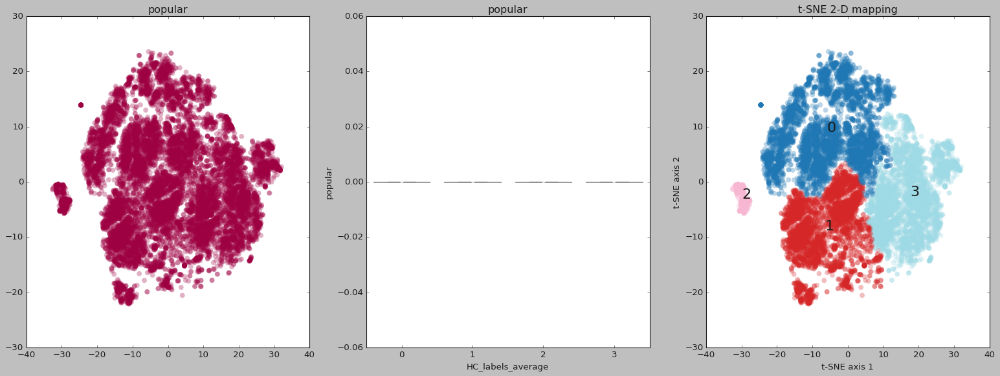

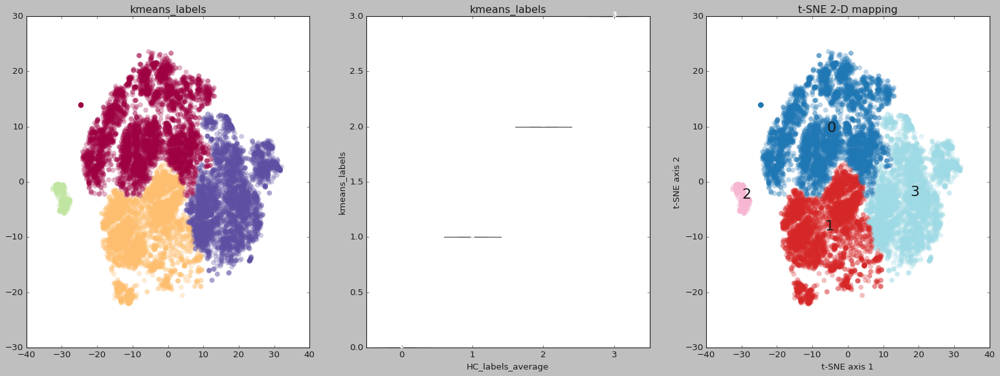

In [97]:
# boxplot across clusters for each feature ...
import seaborn as sns
sns.set_palette("husl")
plt.style.use('classic')

col_names = X_all_together.columns.values.tolist()

for col in col_names :
    
    _ = plt.figure(figsize=(24, 8));
    
# ... feature distribution color map 

    #_ = plt.subplot(131, facecolor = 'darkgrey');
    _ = plt.subplot(131);
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)
    
# ... feature boxplots

    _ = plt.subplot(132);
    ax = sns.boxplot(x = "kmeans_labels", y = col, data = X_all_together);
    _ = plt.xlabel("HC_labels_average");
    _ = plt.title(col)

    
    average_values = X_all_together.groupby(['kmeans_labels'])[col].mean().values
    average_labels = [str(np.round(s, 2)) for s in average_values]

    pos = range(len(average_values))
    for tick, label in zip(pos, ax.get_xticklabels()):
        
        _ = ax.text(pos[tick], average_values[tick], average_labels[tick], 
                horizontalalignment = 'center', size = 'small', color = 'w', weight = 'semibold')

# ... cluster color map
    
    _ = plt.subplot(133);
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = hc_labels_average,
                 cmap = plt.cm.tab20,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    for ii in range(n_lda) :                                       
          _ = plt.text(hc_centers_x[ii], hc_centers_y[ii], ii, fontsize = 20)
     
        
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    _ = plt.title('t-SNE 2-D mapping')
    plt.savefig("../plots/hierarchical/cluster_HC_average_3way_preplx_100__4clstrs%s.png" %col)

    _ = plt.show();

# Modeling and Evaluation 4: 
####  summarize results

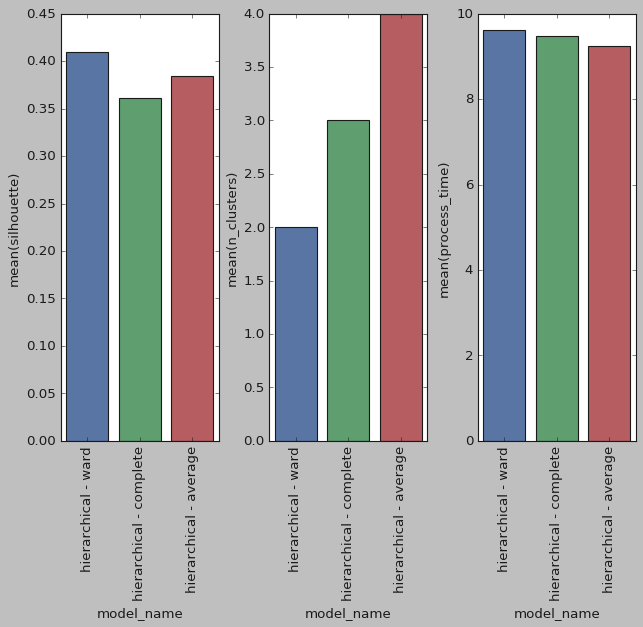

In [98]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison of hierarchical clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

from pylab import rcParams
%matplotlib inline
sns.set_palette("husl")
plt.style.use('classic')


fig, axs = plt.subplots(ncols=3)
fig.tight_layout()
_=plt.figure(figsize=(24, 24))
_=plt.setp(axs[0].xaxis.get_majorticklabels(), rotation = 90 )
_=plt.setp(axs[1].xaxis.get_majorticklabels(), rotation = 90 )
_=plt.setp(axs[2].xaxis.get_majorticklabels(), rotation = 90 )

_=sns.barplot(x = 'model_name', y = 'silhouette', data = tsne_tbl, ax = axs[0])
_=sns.barplot(x = 'model_name', y = 'n_clusters', data = tsne_tbl, ax = axs[1])
_=sns.barplot(x = 'model_name', y = 'process_time', data = tsne_tbl, ax = axs[2])
plt.savefig("../plots/hierarchical/cluster_HC_comparison_of_metrics")


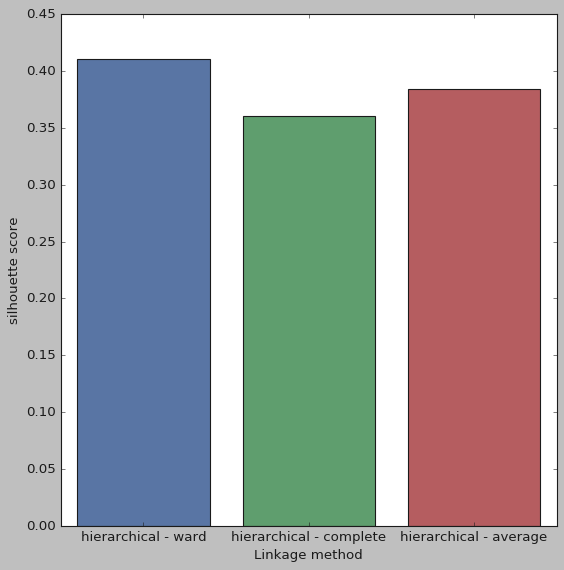

In [113]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison of hierarchical clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

from pylab import rcParams
%matplotlib inline
sns.set_palette("husl")
plt.style.use('classic')

_ = plt.figure(figsize=(8, 8));
#fig, axs = plt.subplots(ncols=1)
#_=plt.setp(axs[0].xaxis.get_majorticklabels(), rotation = 90 )

#_=plt.setp(axs[1].xaxis.get_majorticklabels(), rotation = 90 )
#_=plt.setp(axs[2].xaxis.get_majorticklabels(), rotation = 90 )

ax = sns.barplot(x = 'model_name', y = 'silhouette', data = tsne_tbl) #, ax = axs[0])
#_=sns.barplot(x = 'model_name', y = 'n_clusters', data = tsne_tbl, ax = axs[1])
#_=sns.barplot(x = 'model_name', y = 'process_time', data = tsne_tbl, ax = axs[2])
#plt.savefig("../plots/hierarchical/cluster_HC_comparison_of_metrics_S")
_ = plt.ylabel("silhouette score");
_ = plt.xlabel("Linkage method");
plt.savefig("../plots/hierarchical/HC_comparison_of_metrics_silhouette")
_=plt.show()


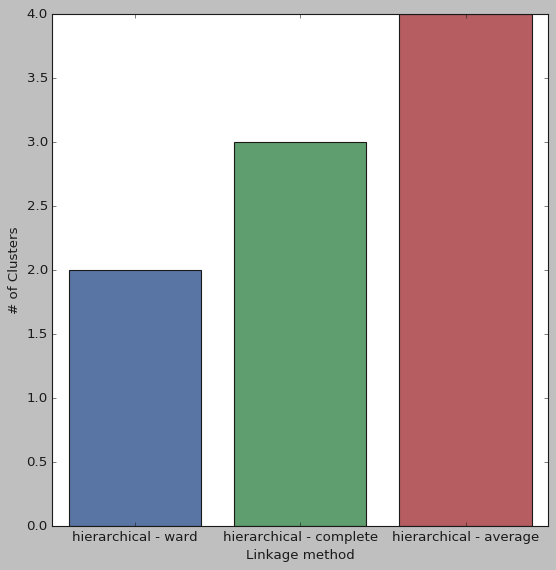

In [112]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison of hierarchical clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

from pylab import rcParams
%matplotlib inline
sns.set_palette("husl")
plt.style.use('classic')

_ = plt.figure(figsize=(8, 8));
#fig, axs = plt.subplots(ncols=1)
#_=plt.setp(axs[0].xaxis.get_majorticklabels(), rotation = 90 )

#_=plt.setp(axs[1].xaxis.get_majorticklabels(), rotation = 90 )
#_=plt.setp(axs[2].xaxis.get_majorticklabels(), rotation = 90 )

#ax = sns.barplot(x = 'model_name', y = 'silhouette', data = tsne_tbl) #, ax = axs[0])
_=sns.barplot(x = 'model_name', y = 'n_clusters', data = tsne_tbl) #, ax = axs[1])
#_=sns.barplot(x = 'model_name', y = 'process_time', data = tsne_tbl, ax = axs[2])
#plt.savefig("../plots/hierarchical/cluster_HC_comparison_of_metrics_S")
_ = plt.ylabel("# of Clusters");
_ = plt.xlabel("Linkage method");
plt.savefig("../plots/hierarchical/HC_comparison_of_metrics_clusters")
_=plt.show()


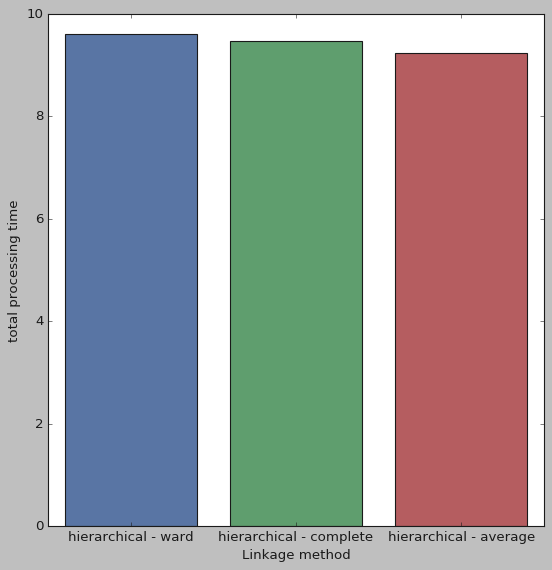

In [115]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison of hierarchical clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

from pylab import rcParams
%matplotlib inline
sns.set_palette("husl")
plt.style.use('classic')

_ = plt.figure(figsize=(8, 8));
#fig, axs = plt.subplots(ncols=1)
#_=plt.setp(axs[0].xaxis.get_majorticklabels(), rotation = 90 )

#_=plt.setp(axs[1].xaxis.get_majorticklabels(), rotation = 90 )
#_=plt.setp(axs[2].xaxis.get_majorticklabels(), rotation = 90 )

#ax = sns.barplot(x = 'model_name', y = 'silhouette', data = tsne_tbl) #, ax = axs[0])
#_=sns.barplot(x = 'model_name', y = 'n_clusters', data = tsne_tbl, ax = axs[1])
_=sns.barplot(x = 'model_name', y = 'process_time', data = tsne_tbl) #, ax = axs[2])
#plt.savefig("../plots/hierarchical/cluster_HC_comparison_of_metrics_S")
_ = plt.ylabel("total processing time");
_ = plt.xlabel("Linkage method");
plt.savefig("../plots/hierarchical/HC_comparison_of_metrics_time")
_=plt.show()


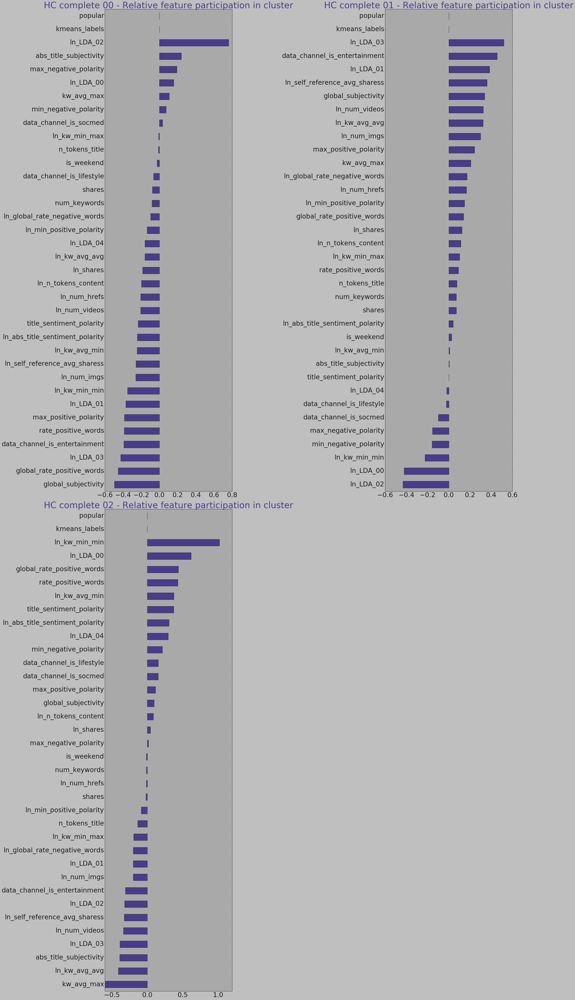

In [116]:

n_optimal_clusters = n_optimal_cluster_complete


_ = plt.figure(figsize=(36, 64));
    

plot_rows = int((n_optimal_clusters + 1)/2)

for ii in range(n_optimal_clusters) :
    
    ax = plt.subplot(plot_rows, 2, ii+1, facecolor = 'darkgrey');
    
    wgt = pd.Series(HC_Complete_analysis_tbl.ix[ii],
                    index = HC_Complete_analysis_tbl.columns).sort_values(ascending = True)
        
    _ = wgt.plot(kind = 'barh', fontsize = 30, color = 'darkslateblue')
    
    _ = plt.title("HC complete %02d - Relative feature participation in cluster" %ii,
                  fontsize = 40,
                 color = 'darkslateblue')
    
    _ = plt.tight_layout()
    
plt.savefig("../plots/hierarchical/HC_complete_feature_importance.png")

plt.show()

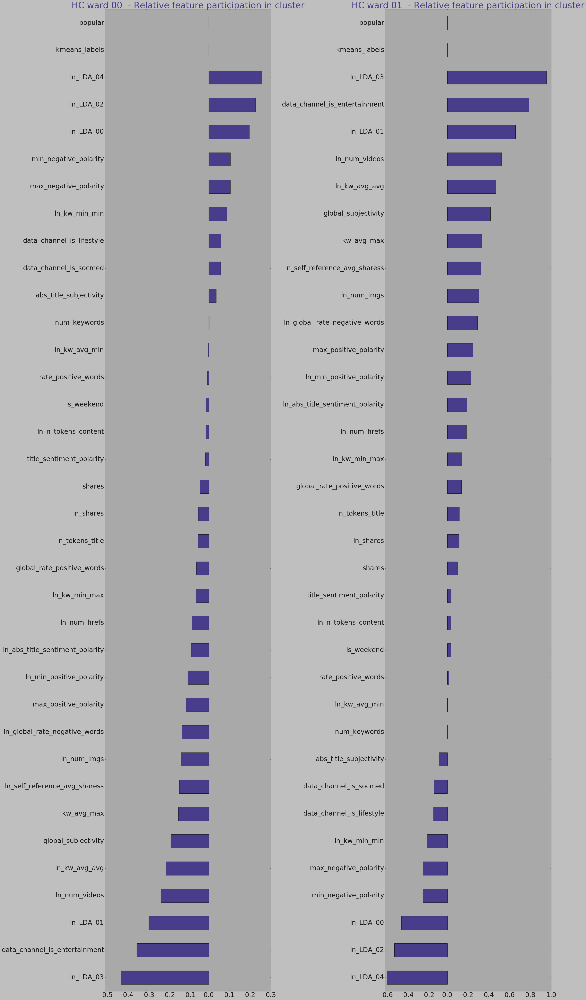

In [118]:
n_optimal_clusters = n_optimal_cluster_ward


_ = plt.figure(figsize=(36, 64));
    

plot_rows = int((n_optimal_clusters + 1)/2)

for ii in range(n_optimal_clusters) :
    
    ax = plt.subplot(plot_rows, 2, ii+1, facecolor = 'darkgrey');
    
    wgt = pd.Series(HC_ward_analysis_tbl.ix[ii],
                    index = HC_ward_analysis_tbl.columns).sort_values(ascending = True)
        
    _ = wgt.plot(kind = 'barh', fontsize = 30, color = 'darkslateblue')
    
    _ = plt.title("HC ward %02d  - Relative feature participation in cluster" %ii,
                  fontsize = 40,
                 color = 'darkslateblue')
    
    _ = plt.tight_layout()
    
plt.savefig("../plots/hierarchical/HC_ward_feature_importance.png")

plt.show()

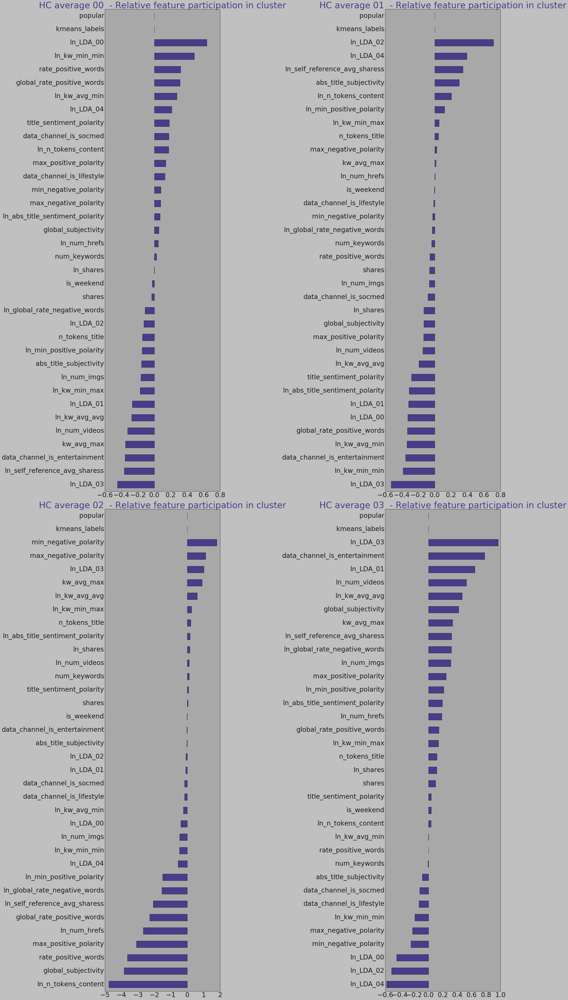

In [117]:
n_optimal_clusters = n_optimal_cluster_average 


_ = plt.figure(figsize=(36, 64));
    

plot_rows = int((n_optimal_clusters + 1)/2)

for ii in range(n_optimal_clusters) :
    
    ax = plt.subplot(plot_rows, 2, ii+1, facecolor = 'darkgrey');
    
    wgt = pd.Series(HC_average_analysis_tbl.ix[ii],
                    index = HC_average_analysis_tbl.columns).sort_values(ascending = True)
        
    _ = wgt.plot(kind = 'barh', fontsize = 30, color = 'darkslateblue')
    
    _ = plt.title("HC average %02d  - Relative feature participation in cluster" %ii,
                  fontsize = 40,
                 color = 'darkslateblue')
    
    _ = plt.tight_layout()
    
plt.savefig("../plots/hierarchical/HC_average_feature_importance.png")

plt.show()

### using plots, identify behavior of clusters, identify any patterns visible

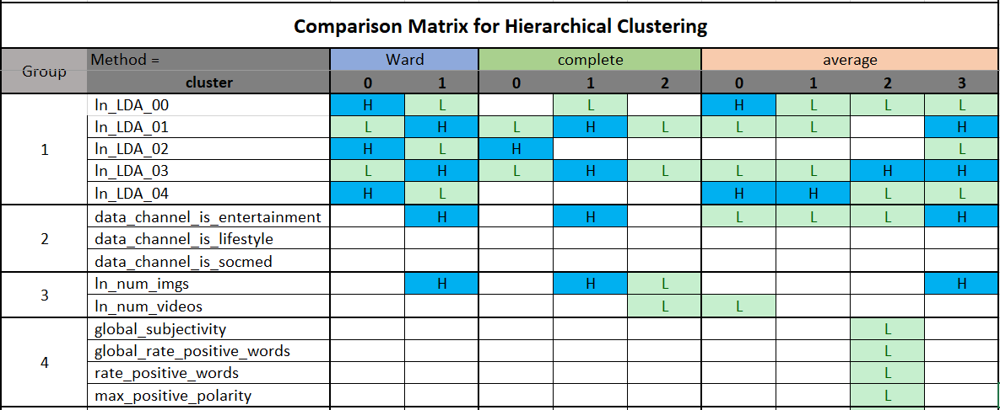

In [62]:
from IPython.display import Image
Image("../plots/hierarchical/HC_comparisonMatrix.png")

For our analysis, we will look into each of the hierarchical models and compare the behaviour of features under each type. We will start by looking at the <b>comparison matrix</b>.

1. LDA00 thru LDA04:
We can see that overall LDA00 thru LDA04 are highly impactful in creating clusters for all 3 types of models. What is interesting here is LDA_04, Ward and average methods used this feature values to distinguish clusters but complete spread it evenly betweem all 3 clusters. Looking at the LDAs, we can clearly see that 'Ward' makes high and low value clusters.<br><br>

2. data_channel (Entertainment, social media, lifestyle):
Among all data_channels, Entertainment, Lifestyle and Social media features are in our final list of features. entertainment has made an impact on all 3 models in forming clusters. Most entertainment values have formed a strong cluster of its own. Cluster 1 of 'ward', cluster 1 of 'complete' and culster 4 of 'average' can be called high-entertainment cluster. Among the 3, entertain ment has huge data with 7K mashable links while Social media and lifestyle has only around 2k.<br><br> 

3.  Numbers like images, videos:
These features are particularly interesting as they behave differently for each of the models. while low videos form a cluster in complete and average, ward method shows no deviation. The images however form a cluster based on the images in an article. Ward and complete have formed a cluster with high number of images. Also, a high number of images also forms strong bond with entertainment<br><br>

4. Global appeal and postivity: ( global_subjectivity, global_rate_positive_words, rate_positive_words, max_positive_polarity)
These set of features are interesting to note as it shows strongly impactful in 'average' but has no impact in other two methods. The 'average' method formed cluster 2 which could be named as low global appeal and low positive words. This is the same cluster which was low on LDA_00 and LDA_04.<br><br>

5. Each method by itself:<br>
    a. <b>ward</b>: Just 2 clusters, with LDAs being major factors, number of images and data_channel entertainment. Cluster 1 is high images and entertainment, there is strong visual importance here. cluster 0 is low image count and ????

    b. <b>complete</b>: 3 clusters, cluster 1 is strong on LDA_01, LDA_03, entertainment and high image count. This is somewhat similar to cluster 1 of ward for high values. While complete forms a different cluster, cluster 2 for low values of these features. while cluster 0 is mostly LDA_02 and low values of LDA_01, LDA_03.
    
    c. <b>average</b>: formed 4 clusters. Cluster 3 is high on LDA_01, LDA_03, images and entertainment. this is consistent with other methods as well. Cluster 0 strong on LDA_00 and LDA_04 and away from entertainment and videos. Cluster 2 seems a very small cluster mostly of LDA_03 values with low entertainment values.<br><br>
    
<b><u>Patterns</u></b>:<br>
    LDA_01, LDA_03, entertainment and imgaes are consistently together. Clearly certain set of vocabulary related to entertainment are found in LDA_01 and LDA_03. Putting this together with number of shares, the high shares under entertainment like <i>"McDonalds Kills Site That Advised Employees to Eat Healthy Meals", "What to Do With Your New Xbox one" </i> have high count of images, more than 10,<br><br>
    while low shares under entertainment like <i>"11 TV Characters Older Than the Class of 2018", "Hasbro Games Show Signs of Life in iPad World"</i> show 1 to none images.
    


Notes:
The patterns observed here is specific to the data we took to analyze. We cannot extrapolate these behavior to future mashable data.
    